#   <font color = Dark Pink>Lending Club Case Study - EDA  </font>

## Problem Statement

####  <font color = orange>Lending Club : It is a marketplace for personal loans that matches borrowers who are seeking a loan with investors looking to lend money and make a return. </font>

A consumer finance company which specialises in lending various types of loans to urban customers, when receives a loan application, the company has to make a decision for loan approval based on the applicant’s profile. <br>Two types of risks are associated with the bank’s decision:

1. If the applicant is likely to repay the loan, then not approving the loan results in a loss of business to the company.

2. If the applicant is not likely to repay the loan, i.e. he/she is likely to default, then approving the loan may lead to a financial loss for the company



#####  The aim is to identify patterns which indicate if a person is likely to default, which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc. 


In [1]:
#Import necessary libraries for EDA :
import pandas as pd
import numpy as np


##visualization libraries:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as py                                   
py.init_notebook_mode(connected=True)                         
import plotly.graph_objs as go                               
import plotly.tools as tls
import plotly.figure_factory as ff


# display float value with correct precision:
pd.set_option('float_format', '{:f}'.format)


# display all columns:
pd.set_option('display.max_columns', None)          

In [2]:
#loading the dataset into dataframe:

df = pd.read_csv("loan.csv")
df.head()

C:\Users\admin\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning:

Columns (47) have mixed types.Specify dtype option on import or set low_memory=False.



,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.000000,36 months,10.65%,162.870000,B,B2,NaN,10+ years,RENT,24000.000000,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.650000,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.000000,0.000000,5863.155187,5833.840000,5000.000000,863.160000,0.000000,0.000000,0.000000,Jan-15,171.620000,NaN,May-16,0.000000,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.000000,60 months,15.27%,59.830000,C,C4,Ryder,< 1 year,RENT,30000.000000,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.000000,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.000000,0.000000,1008.710000,1008.710000,456.460000,435.170000,0.000000,117.080000,1.110000,Apr-13,119.660000,NaN,Sep-13,0.000000,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.000000,36 months,15.96%,84.330000,C,C5,NaN,10+ years,RENT,12252.000000,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.720000,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.000000,0.000000,3005.666844,3005.670000,2400.000000,605.670000,0.000000,0.000000,0.000000,Jun-14,649.910000,NaN,May-16,0.000000,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.000000,36 months,13.49%,339.310000,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.000000,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.000000,0,Feb-96,1,35.000000,NaN,10,0,5598,21%,37,f,0.000000,0.00

In [3]:
#know the shape of dataframe:

df.shape                     


(39717, 111)

In [4]:
#know the all columns:

df.columns


Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       ...
       'num_tl_90g_dpd_24m', 'num_tl_op_past_12m', 'pct_tl_nvr_dlq',
       'percent_bc_gt_75', 'pub_rec_bankruptcies', 'tax_liens',
       'tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit',
       'total_il_high_credit_limit'],
      dtype='object', length=111)

In [5]:
#view the information of df:

df.info()         

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


In [6]:
#view info of all columns:

df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 111 columns):
 #    Column                          Non-Null Count  Dtype  
---   ------                          --------------  -----  
 0    id                              39717 non-null  int64  
 1    member_id                       39717 non-null  int64  
 2    loan_amnt                       39717 non-null  int64  
 3    funded_amnt                     39717 non-null  int64  
 4    funded_amnt_inv                 39717 non-null  float64
 5    term                            39717 non-null  object 
 6    int_rate                        39717 non-null  object 
 7    installment                     39717 non-null  float64
 8    grade                           39717 non-null  object 
 9    sub_grade                       39717 non-null  object 
 10   emp_title                       37258 non-null  object 
 11   emp_length                      38642 non-null  object 
 12   home_ownership  

**`Observation`**: 
    <br>
    
<font color = blue>1. There are 39717 rows and 111 columns.<br>
2. Most of the columns seems to be null.<br>
3. Most of the numeric columns dtype is object.<br></font>

#   <font color =Green> Data Cleaning :  </font>

##   <font color =Crimson> Missing Value Analysis  </font>

In [7]:
#Let us analyse the null columns:

df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 111 columns):
 #    Column                          Non-Null Count  Dtype  
---   ------                          --------------  -----  
 0    id                              39717 non-null  int64  
 1    member_id                       39717 non-null  int64  
 2    loan_amnt                       39717 non-null  int64  
 3    funded_amnt                     39717 non-null  int64  
 4    funded_amnt_inv                 39717 non-null  float64
 5    term                            39717 non-null  object 
 6    int_rate                        39717 non-null  object 
 7    installment                     39717 non-null  float64
 8    grade                           39717 non-null  object 
 9    sub_grade                       39717 non-null  object 
 10   emp_title                       37258 non-null  object 
 11   emp_length                      38642 non-null  object 
 12   home_ownership  

## Droping off the columns which have all null values :

In [8]:
#remove or drop the columns in which all values are missing

df = df.dropna( axis='columns',how='all') 


In [9]:
#check null columns dropped or not

df.info(verbose=True, show_counts=True)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 57 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          39717 non-null  int64  
 1   member_id                   39717 non-null  int64  
 2   loan_amnt                   39717 non-null  int64  
 3   funded_amnt                 39717 non-null  int64  
 4   funded_amnt_inv             39717 non-null  float64
 5   term                        39717 non-null  object 
 6   int_rate                    39717 non-null  object 
 7   installment                 39717 non-null  float64
 8   grade                       39717 non-null  object 
 9   sub_grade                   39717 non-null  object 
 10  emp_title                   37258 non-null  object 
 11  emp_length                  38642 non-null  object 
 12  home_ownership              39717 non-null  object 
 13  annual_inc                  397

### **`Now we are left with 57 columns`** 

In [10]:
#check for null values in column:

df.isnull().sum()

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
term                              0
int_rate                          0
installment                       0
grade                             0
sub_grade                         0
emp_title                      2459
emp_length                     1075
home_ownership                    0
annual_inc                        0
verification_status               0
issue_d                           0
loan_status                       0
pymnt_plan                        0
url                               0
desc                          12940
purpose                           0
title                            11
zip_code                          0
addr_state                        0
dti                               0
delinq_2yrs                       0
earliest_cr_line                  0
inq_last_6mths              

**`There are other columns having large num of null values.` <br> `Let us check the mean of each column.`** 

In [11]:

#Let us check the average value of features:

df.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,policy_code,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens
count,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,14035.000000,2786.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39661.000000,39717.000000,39717.000000,39661.000000,39717.000000,39020.000000,39678.000000
mean,683131.913060,850463.559408,11219.443815,10947.713196,10397.448868,324.561922,68968.926377,13.315130,0.146512,0.869200,35.900962,69.698134,9.294408,0.055065,13382.528086,22.088828,51.227887,50.989768,12153.596544,11567.149118,9793.348813,2263.663172,1.363015,95.221624,12.406112,2678.826162,0.000000,1.000000,0.000000,0.000000,0.000000,0.043260,0.000000
std,210694.132915,265678.307421,7456.670694,7187.238670,7128.450439,208.874874,63793.765790,6.678594,0.491812,1.070219,22.020060,43.822529,4.400282,0.237200,15885.016641,11.401709,375.172839,373.824457,9042.040766,8942.672613,7065.522127,2608.111964,7.289979,688.744771,148.671593,4447.136012,0.000000,0.000000,0.000000,0.000000,0.000000,0.204324,0.000000
min,54734.000000,70699.000000,500.000000,500.000000,0.000000,15.690000,4000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,516221.000000,666780.000000,5500.000000,5400.000000,5000.000000,167.020000,40404.000000,8.170000,0.000000,0.000000,18.000000,22.000000,6.000000,0.000000,3703.000000,13.000000,0.000000,0.000000,5576.930000,5112.310000,4600.000000,662.180000,0.000000,0.000000,0.000000,218.680000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,665665.000000,850812.000000,10000.000000,9600.000000,8975.000000,280.220000,59000.000000,13.400000,0.000000,1.000000,34.000000,90.000000,9.000000,0.000000,8850.000000,20.000000,0.000000,0.000000,9899.640319,9287.150000,8000.000000,1348.910000,0.000000,0.000000,0.000000,546.140000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,837755.000000,1047339.000000,15000.000000,15000.000000,14400.000000,430.780000,82300.000000,18.600000,0.000000,1.000000,52.000000,104.000000,12.000000,0.000000,17058.000000,29.000000,0.000000,0.000000,16534.433040,15798.810000,13653.260000,2833.400000,0.000000,0.000000,0.000000,3293.160000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1077501.000000,1314167.000000,35000.000000,35000.000000,35000.000000,1305.190000,6000000.000000,29.990000,11.000000,8.000000,120.000000,129.000000,44.000000,4.000000,149588.000000,90.000000,6311.470000,6307.370000,58563.679930,58563.680000,35000.020000,23563.680000,180.200000,29623.350000,7002.190000,36115.200000,0.000000,1.000000,0.000000,0.000000,0.000000,2.000000,0.000000


In [12]:

#Let us check the mean value of each column:

df.isnull().mean()            

id                           0.000000
member_id                    0.000000
loan_amnt                    0.000000
funded_amnt                  0.000000
funded_amnt_inv              0.000000
term                         0.000000
int_rate                     0.000000
installment                  0.000000
grade                        0.000000
sub_grade                    0.000000
emp_title                    0.061913
emp_length                   0.027066
home_ownership               0.000000
annual_inc                   0.000000
verification_status          0.000000
issue_d                      0.000000
loan_status                  0.000000
pymnt_plan                   0.000000
url                          0.000000
desc                         0.325805
purpose                      0.000000
title                        0.000277
zip_code                     0.000000
addr_state                   0.000000
dti                          0.000000
delinq_2yrs                  0.000000
earliest_cr_

## Droping off the columns having >= 50% missing values

In [13]:

#columns having >= 50% missing values

df.columns[df.isnull().mean() >= 0.5]     

Index(['mths_since_last_delinq', 'mths_since_last_record', 'next_pymnt_d'], dtype='object')

In [14]:

#columns having <= 50% missing values

df.columns[df.isnull().mean() < 0.5]


Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'desc', 'purpose',
       'title', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc', 'initial_list_status',
       'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt',
       'last_credit_pull_d', 'collections_12_mths_ex_med', 'policy_code',
       'application_type', 'acc_now_delinq', 'chargeoff_within_12_mths',
       'delinq_amnt', 'pub_rec_bankruptcies', 'tax_liens'],
      dtype='object')

In [15]:

# we replace the df with columns that have <50% of missing values

df = df[df.columns[df.isnull().mean() < 0.5]]  


In [16]:

#['mths_since_last_delinq', 'mths_since_last_record', 'next_pymnt_d'] columns are removed

df            


,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens
0,1077501,1296599,5000,5000,4975.000000,36 months,10.65%,162.870000,B,B2,NaN,10+ years,RENT,24000.000000,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.650000,0,Jan-85,1,3,0,13648,83.70%,9,f,0.000000,0.000000,5863.155187,5833.840000,5000.000000,863.160000,0.000000,0.000000,0.000000,Jan-15,171.620000,May-16,0.000000,1,INDIVIDUAL,0,0.000000,0,0.000000,0.000000
1,1077430,1314167,2500,2500,2500.000000,60 months,15.27%,59.830000,C,C4,Ryder,< 1 year,RENT,30000.000000,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.000000,0,Apr-99,5,3,0,1687,9.40%,4,f,0.000000,0.000000,1008.710000,1008.710000,456.460000,435.170000,0.000000,117.080000,1.110000,Apr-13,119.660000,Sep-13,0.000000,1,INDIVIDUAL,0,0.000000,0,0.000000,0.000000
2,1077175,1313524,2400,2400,2400.000000,36 months,15.96%,84.330000,C,C5,NaN,10+ years,RENT,12252.000000,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.720000,0,Nov-01,2,2,0,2956,98.50%,10,f,0.000000,0.000000,3005.666844,3005.670000,2400.000000,605.670000,0.000000,0.000000,0.000000,Jun-14,649.910000,May-16,0.000000,1,INDIVIDUAL,0,0.000000,0,0.000000,0.000000
3,1076863,1277178,10000,10000,10000.000000,36 months,13.49%,339.310000,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.000000,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.000000,0,Feb-96,1,10,0,5598,21%,37,f,0.000000,0.000000,12231.890000,12231.890000,10000.000000,2214.920000,16.970000,0.000000,0.000000,Jan-15,357.480000,Apr-16,0.000000,1,INDIVIDUAL,0,0.000000,0,0.000000,0.000000
4,1075358,1311748,3000,3000,3000.000000,60 months,12.69%,67.790000,B,B5,University Medical Group,1 year,RENT,80000.000000,Source Verified,Dec-11,Current,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.940000,0,Jan-96,0,15,0,27783,53.90%,38,f,524.060000,524.060000,3513.330000,3513.330000,2475.940000,1037.390000,0.000000,0.000000,0.000000,May-16,67.790000,May-16,0.000000,1,INDIVIDUAL,0,0.000000,0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,92187,92174,2500,2500,1075.000000,36 months,8.07%,78.420000,A,A4,FiSite Research,4 years,MORTGAGE,110000.000000,Not Verified,Jul-07,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Our current gutter system on our home is old a...,home_improvement,Home Improvement,802xx,CO,11.330000,0,Nov-90,0,13,0,7274,13.10%,40,f,0.000000,0.000000,2822.969293,1213.880000,2500.000000,322.970000,0.000000,0.000000,0.000000,Jul-10,80.900000,Jun-10,NaN,1,INDIVIDUAL,0,NaN,0,NaN,NaN
39713,90665,90607,8500,8500,875.000000,36 months,10.28%,275.380000,C,C1,"Squarewave Solutions, Ltd.",3 years,RENT,18000.000000,Not Verified,Jul-07,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,The rate of interest and fees

**`Columns having more than 50% of missing value are dropped`**

#   <font color =Crimson> Identify relevant variables </font>

### <span style= 'background:lime'>  ASSUMPTION  </span>

<span style= 'background:yellow'>  By going through the data dictionary, we can know there are some variables those are generated after the loan is approved such as collection_recovery_fee, delinquent 2 years, earliest_cr_line, revolving balance, next payment date etc.
Since these variables are not available at the time of loan application, and thus assuming that these variables cannot be used as predictors for loan approval.
</span>

In [17]:

#Dropping the columns that doesn't contribute to our goal:

df.drop(['delinq_2yrs', 'earliest_cr_line' ,'inq_last_6mths','open_acc','pub_rec',
         'revol_bal', 'revol_util', 'total_acc', 'out_prncp', 'out_prncp_inv', 
         'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp',
         'total_rec_int', 'total_rec_late_fee',
         'recoveries', 'collection_recovery_fee',
         'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d',
         'application_type'], axis=1,inplace=True)

In [18]:

#check for the remaining column:

df.shape

(39717, 33)

#  <font color =Crimson> Identifying Unimportant Variables  </font>

In [19]:

#check all remaining columns:

df.columns


Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'pymnt_plan', 'url', 'desc', 'purpose',
       'title', 'zip_code', 'addr_state', 'dti', 'initial_list_status',
       'collections_12_mths_ex_med', 'policy_code', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'pub_rec_bankruptcies',
       'tax_liens'],
      dtype='object')

#### Identifying the columns to drop:

**`Hence dropping off above 17 columns`**

In [20]:

#Store the identified umimportant columns in list:

unimp_cols = ['id', 'member_id','emp_title','url','zip_code','addr_state','funded_amnt','pymnt_plan','desc','title','initial_list_status','collections_12_mths_ex_med','policy_code','acc_now_delinq','chargeoff_within_12_mths','delinq_amnt','tax_liens']


In [21]:

#dropping the identified umimportant columns:

df.drop( unimp_cols, axis=1, inplace=True)


In [22]:

#check the no of remaining columns:

df.shape                                      

(39717, 16)

**Checking the info of our dataset**

In [23]:

df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             39717 non-null  int64  
 1   funded_amnt_inv       39717 non-null  float64
 2   term                  39717 non-null  object 
 3   int_rate              39717 non-null  object 
 4   installment           39717 non-null  float64
 5   grade                 39717 non-null  object 
 6   sub_grade             39717 non-null  object 
 7   emp_length            38642 non-null  object 
 8   home_ownership        39717 non-null  object 
 9   annual_inc            39717 non-null  float64
 10  verification_status   39717 non-null  object 
 11  issue_d               39717 non-null  object 
 12  loan_status           39717 non-null  object 
 13  purpose               39717 non-null  object 
 14  dti                   39717 non-null  float64
 15  pub_rec_bankruptcie


#  <font color =Crimson> Distribution of Target Variable  </font>

In [24]:

#Check the unique categories and their counts:

df['loan_status'].value_counts()


Fully Paid     32950
Charged Off     5627
Current         1140
Name: loan_status, dtype: int64

**Check distribution of categories visually.**

In [25]:

#Plot pie/doughnut chart:


#labels
lab = df["loan_status"].value_counts().keys().tolist()

#values
val = df["loan_status"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'lime'],
                             line = dict(color = "white",
                                         width =  1.3)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Customer attrition in data",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)



### `Observation from chart`: 
    
<font color = blue>'Current' means the applicant is in the process of paying the instalments, i.e. the tenure of the loan is not yet completed. These candidates are neither labelled as 'defaulted' nor as 'fully paid'
Hence,need to drop off the records whose loan status is "Current"<br></font>

In [26]:

#Check df for "current" applicants:

df[df['loan_status']=="Current"]              

,loan_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,dti,pub_rec_bankruptcies
4,3000,3000.000000,60 months,12.69%,67.790000,B,B5,1 year,RENT,80000.000000,Source Verified,Dec-11,Current,other,17.940000,0.000000
32,10000,9975.000000,60 months,15.96%,242.970000,C,C5,2 years,RENT,29120.000000,Verified,Dec-11,Current,debt_consolidation,22.830000,0.000000
39,12500,12475.000000,60 months,12.69%,282.440000,B,B5,1 year,RENT,27000.000000,Verified,Dec-11,Current,debt_consolidation,16.040000,0.000000
86,14000,13975.000000,60 months,17.27%,349.980000,D,D3,4 years,RENT,28000.000000,Verified,Dec-11,Current,other,6.340000,0.000000
95,15300,15275.000000,60 months,22.06%,423.100000,F,F4,6 years,RENT,85000.000000,Verified,Dec-11,Current,credit_card,20.580000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15972,10400,10400.000000,60 months,6.00%,218.990000,E,E3,5 years,MORTGAGE,29000.000000,Source Verified,May-11,Current,credit_card,10.840000,0.000000
15981,6000,6000.000000,60 months,10.37%,128.580000,B,B3,1 year,RENT,24000.000000,Source Verified,Apr-11,Current,car,11.050000,0.000000
16361,19200,18847.762920,60 months,10.74%,414.970000,B,B4,5 years,MORTGAGE,100000.000000,Verified,Apr-11,Current,small_business,4.430000,0.000000
16609,9350,9350.000000,60 months,10.00%,198.660000,B,B2,8 years,RENT,66000.000000,Not Verified,Apr-11,Current,car,4.840000,0.000000



**`There are total 1140 rows having loan_status == current `**

In [27]:

df['loan_status']=="Current"       # True if loan_status ='Current'


0        False
1        False
2        False
3        False
4         True
         ...  
39712    False
39713    False
39714    False
39715    False
39716    False
Name: loan_status, Length: 39717, dtype: bool

**`Dropping the 'Current' loan status`** 

In [28]:

df = df[df["loan_status"].apply(lambda x : False if x == "Current" else True)]
df.head()


,loan_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,dti,pub_rec_bankruptcies
0,5000,4975.000000,36 months,10.65%,162.870000,B,B2,10+ years,RENT,24000.000000,Verified,Dec-11,Fully Paid,credit_card,27.650000,0.000000
1,2500,2500.000000,60 months,15.27%,59.830000,C,C4,< 1 year,RENT,30000.000000,Source Verified,Dec-11,Charged Off,car,1.000000,0.000000
2,2400,2400.000000,36 months,15.96%,84.330000,C,C5,10+ years,RENT,12252.000000,Not Verified,Dec-11,Fully Paid,small_business,8.720000,0.000000
3,10000,10000.000000,36 months,13.49%,339.310000,C,C1,10+ years,RENT,49200.000000,Source Verified,Dec-11,Fully Paid,other,20.000000,0.000000
5,5000,5000.000000,36 months,7.90%,156.460000,A,A4,3 years,RENT,36000.000000,Source Verified,Dec-11,Fully Paid,wedding,11.200000,0.000000


In [29]:

df.shape                            # 1140 rows having loan_status ="current" dropped off, now df left with 38577 rows


(38577, 16)

## Encoding the loan_status as 1 and 0

Set 1 for "Charged Off" and 0 for "Fully Paid"

In [30]:

df["loan_status"] = df["loan_status"].apply(lambda x: 1 if x == "Charged Off" else 0)
df


,loan_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,dti,pub_rec_bankruptcies
0,5000,4975.000000,36 months,10.65%,162.870000,B,B2,10+ years,RENT,24000.000000,Verified,Dec-11,0,credit_card,27.650000,0.000000
1,2500,2500.000000,60 months,15.27%,59.830000,C,C4,< 1 year,RENT,30000.000000,Source Verified,Dec-11,1,car,1.000000,0.000000
2,2400,2400.000000,36 months,15.96%,84.330000,C,C5,10+ years,RENT,12252.000000,Not Verified,Dec-11,0,small_business,8.720000,0.000000
3,10000,10000.000000,36 months,13.49%,339.310000,C,C1,10+ years,RENT,49200.000000,Source Verified,Dec-11,0,other,20.000000,0.000000
5,5000,5000.000000,36 months,7.90%,156.460000,A,A4,3 years,RENT,36000.000000,Source Verified,Dec-11,0,wedding,11.200000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,2500,1075.000000,36 months,8.07%,78.420000,A,A4,4 years,MORTGAGE,110000.000000,Not Verified,Jul-07,0,home_improvement,11.330000,NaN
39713,8500,875.000000,36 months,10.28%,275.380000,C,C1,3 years,RENT,18000.000000,Not Verified,Jul-07,0,credit_card,6.400000,NaN
39714,5000,1325.000000,36 months,8.07%,156.840000,A,A4,< 1 year,MORTGAGE,100000.000000,Not Verified,Jul-07,0,debt_consolidation,2.300000,NaN
39715,5000,650.000000,36 months,7.43%,155.380000,A,A2,< 1 year,MORTGAGE,200000.000000,Not Verified,Jul-07,0,other,3.720000,NaN


# <font color =Crimson> Handling the Incorrect Dtypes:  </font>

In [31]:
#Check the info() to make some analysis of other columns:

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             38577 non-null  int64  
 1   funded_amnt_inv       38577 non-null  float64
 2   term                  38577 non-null  object 
 3   int_rate              38577 non-null  object 
 4   installment           38577 non-null  float64
 5   grade                 38577 non-null  object 
 6   sub_grade             38577 non-null  object 
 7   emp_length            37544 non-null  object 
 8   home_ownership        38577 non-null  object 
 9   annual_inc            38577 non-null  float64
 10  verification_status   38577 non-null  object 
 11  issue_d               38577 non-null  object 
 12  loan_status           38577 non-null  int64  
 13  purpose               38577 non-null  object 
 14  dti                   38577 non-null  float64
 15  pub_rec_bankruptcie

**`Observations from  df.info() :`**

<font color = blue> 1. emp_length  : dtype is object with few null values <br>
2. Need to convert this column in int and impute the missing values</font>
  


## <span style= 'background:gold'> 1. Emp_length : </span>

In [32]:
#check the unique values in column

df['emp_length'].unique()


array(['10+ years', '< 1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '1 year', '6 years', '2 years', '7 years',
       nan], dtype=object)

In [33]:
df['emp_length'].count()


37544

In [34]:
#as we can see 'emp_length' contains few nan values, so we can drop those rows

df.dropna(axis=0, subset=["emp_length"], inplace=True)

In [35]:

df['emp_length'].unique()


array(['10+ years', '< 1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '1 year', '6 years', '2 years', '7 years'],
      dtype=object)

**Need to remove special chars(+,<,) and convert it into int (removing suffix "years")**

**<span style= 'background:lime'> So let's Assume: : </span>**

1. '3 years'  = 3 (for all mentioned years) <br>
2. '< 1 year' = 0 <br>
3. '10+ years' = 10 <br>


In [36]:

df['emp_length'] = df['emp_length'].apply(lambda x: x.split('+')[0] if '+' in x else (0 if "<" in x else x.split()[0]))


In [37]:

#convert string type into int

df['emp_length'] = df['emp_length'].astype(int)


In [38]:

#verify the dtype:

df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 37544 entries, 0 to 39716
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             37544 non-null  int64  
 1   funded_amnt_inv       37544 non-null  float64
 2   term                  37544 non-null  object 
 3   int_rate              37544 non-null  object 
 4   installment           37544 non-null  float64
 5   grade                 37544 non-null  object 
 6   sub_grade             37544 non-null  object 
 7   emp_length            37544 non-null  int32  
 8   home_ownership        37544 non-null  object 
 9   annual_inc            37544 non-null  float64
 10  verification_status   37544 non-null  object 
 11  issue_d               37544 non-null  object 
 12  loan_status           37544 non-null  int64  
 13  purpose               37544 non-null  object 
 14  dti                   37544 non-null  float64
 15  pub_rec_bankruptcie

## <span style= 'background:gold'> 2. Term : </span>

**`The datatype of "term" column is object which should be int.`**

In [39]:

#Check the unique items:

df['term'].unique()


array([' 36 months', ' 60 months'], dtype=object)

In [40]:

#The column "term" contains suffix 'month' and leading spaces which should be removed.

df['term'] = df['term'].apply(lambda x : x.split()[0])
df['term'] = df['term'].astype(int)
df['term']


0        36
1        60
2        36
3        36
5        36
         ..
39712    36
39713    36
39714    36
39715    36
39716    36
Name: term, Length: 37544, dtype: int32

In [41]:

#check the other columns:

df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 37544 entries, 0 to 39716
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             37544 non-null  int64  
 1   funded_amnt_inv       37544 non-null  float64
 2   term                  37544 non-null  int32  
 3   int_rate              37544 non-null  object 
 4   installment           37544 non-null  float64
 5   grade                 37544 non-null  object 
 6   sub_grade             37544 non-null  object 
 7   emp_length            37544 non-null  int32  
 8   home_ownership        37544 non-null  object 
 9   annual_inc            37544 non-null  float64
 10  verification_status   37544 non-null  object 
 11  issue_d               37544 non-null  object 
 12  loan_status           37544 non-null  int64  
 13  purpose               37544 non-null  object 
 14  dti                   37544 non-null  float64
 15  pub_rec_bankruptcie

## <span style= 'background:gold'> 3. Interest Rate : </span>

**`The datatype of "interest rate" column is object which should be float`**

In [42]:

#check the "interest rate" column

df['int_rate']


0        10.65%
1        15.27%
2        15.96%
3        13.49%
5         7.90%
          ...  
39712     8.07%
39713    10.28%
39714     8.07%
39715     7.43%
39716    13.75%
Name: int_rate, Length: 37544, dtype: object

In [43]:

#int_rate' column includes suffix as '%' which should be removed:


df['int_rate'] = df['int_rate'].apply(lambda x : x.replace('%',''))
df['int_rate'] = df['int_rate'].astype(float)
df['int_rate']


0       10.650000
1       15.270000
2       15.960000
3       13.490000
5        7.900000
           ...   
39712    8.070000
39713   10.280000
39714    8.070000
39715    7.430000
39716   13.750000
Name: int_rate, Length: 37544, dtype: float64

In [44]:

#check the other columns:

df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 37544 entries, 0 to 39716
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   loan_amnt             37544 non-null  int64  
 1   funded_amnt_inv       37544 non-null  float64
 2   term                  37544 non-null  int32  
 3   int_rate              37544 non-null  float64
 4   installment           37544 non-null  float64
 5   grade                 37544 non-null  object 
 6   sub_grade             37544 non-null  object 
 7   emp_length            37544 non-null  int32  
 8   home_ownership        37544 non-null  object 
 9   annual_inc            37544 non-null  float64
 10  verification_status   37544 non-null  object 
 11  issue_d               37544 non-null  object 
 12  loan_status           37544 non-null  int64  
 13  purpose               37544 non-null  object 
 14  dti                   37544 non-null  float64
 15  pub_rec_bankruptcie

## <span style= 'background:gold'> 4. Issue_date: </span>

**`The dtype of 'issue_d' is object. Hence converting this column in datetime format:`**

In [45]:

#Checking the date format:

df['issue_d']


0        Dec-11
1        Dec-11
2        Dec-11
3        Dec-11
5        Dec-11
          ...  
39712    Jul-07
39713    Jul-07
39714    Jul-07
39715    Jul-07
39716    Jun-07
Name: issue_d, Length: 37544, dtype: object

In [46]:

df['issue_d'].unique()


array(['Dec-11', 'Nov-11', 'Oct-11', 'Sep-11', 'Aug-11', 'Jul-11',
       'Jun-11', 'May-11', 'Apr-11', 'Mar-11', 'Feb-11', 'Jan-11',
       'Dec-10', 'Nov-10', 'Oct-10', 'Sep-10', 'Aug-10', 'Jul-10',
       'Jun-10', 'May-10', 'Apr-10', 'Mar-10', 'Feb-10', 'Jan-10',
       'Dec-09', 'Nov-09', 'Oct-09', 'Sep-09', 'Aug-09', 'Jul-09',
       'Jun-09', 'May-09', 'Apr-09', 'Mar-09', 'Feb-09', 'Jan-09',
       'Dec-08', 'Nov-08', 'Oct-08', 'Sep-08', 'Aug-08', 'Jul-08',
       'Jun-08', 'May-08', 'Apr-08', 'Mar-08', 'Feb-08', 'Jan-08',
       'Dec-07', 'Nov-07', 'Oct-07', 'Sep-07', 'Aug-07', 'Jul-07',
       'Jun-07'], dtype=object)

In [47]:

df['issue_d'] = pd.to_datetime(df['issue_d'], format='%b-%y')   #"%b"=Jan,Feb,etc   %y=last two digits of year 
df['issue_d']


0       2011-12-01
1       2011-12-01
2       2011-12-01
3       2011-12-01
5       2011-12-01
           ...    
39712   2007-07-01
39713   2007-07-01
39714   2007-07-01
39715   2007-07-01
39716   2007-06-01
Name: issue_d, Length: 37544, dtype: datetime64[ns]

## Deriving metrics:

#### We can make columns of month and year for analysis:

In [48]:

df['issue_month'] = pd.DatetimeIndex(df['issue_d']).month
df['issue_month'] 


0        12
1        12
2        12
3        12
5        12
         ..
39712     7
39713     7
39714     7
39715     7
39716     6
Name: issue_month, Length: 37544, dtype: int64

In [49]:

df['issue_year'] = pd.DatetimeIndex(df['issue_d']).year
df['issue_year'] 


0        2011
1        2011
2        2011
3        2011
5        2011
         ... 
39712    2007
39713    2007
39714    2007
39715    2007
39716    2007
Name: issue_year, Length: 37544, dtype: int64

In [50]:

df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 37544 entries, 0 to 39716
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   loan_amnt             37544 non-null  int64         
 1   funded_amnt_inv       37544 non-null  float64       
 2   term                  37544 non-null  int32         
 3   int_rate              37544 non-null  float64       
 4   installment           37544 non-null  float64       
 5   grade                 37544 non-null  object        
 6   sub_grade             37544 non-null  object        
 7   emp_length            37544 non-null  int32         
 8   home_ownership        37544 non-null  object        
 9   annual_inc            37544 non-null  float64       
 10  verification_status   37544 non-null  object        
 11  issue_d               37544 non-null  datetime64[ns]
 12  loan_status           37544 non-null  int64         
 13  purpose         

### Missing value Imputation for 'pub_rec_bankruptcies'

In [51]:

#Check if nan is present

df['pub_rec_bankruptcies'].unique()


array([ 0.,  1.,  2., nan])

#### Since there are only three unique values, we can impute missing value with mode.

In [52]:

#impute missing value with mode

df['pub_rec_bankruptcies'] = df['pub_rec_bankruptcies'].fillna(df['pub_rec_bankruptcies'].mode()[0])


In [53]:
df['pub_rec_bankruptcies'].unique()  #nan replaced by mode i.e., 0

array([0., 1., 2.])

In [54]:

#converting 'pub_rec_bankruptcies' dtype into int from float:

df['pub_rec_bankruptcies'] = df['pub_rec_bankruptcies'].astype(int)


In [55]:

#check using describe 

df.describe()


,loan_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,annual_inc,loan_status,dti,pub_rec_bankruptcies,issue_month,issue_year
count,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000,37544.000000
mean,11119.329986,10280.495739,41.917537,11.963319,324.650164,4.940976,69407.080230,0.143805,13.284186,0.041019,7.112881,2010.298530
std,7354.098954,7034.124211,10.344394,3.683012,208.901055,3.557082,64676.984485,0.350896,6.660551,0.199006,3.410257,0.889106
min,500.000000,0.000000,36.000000,5.420000,15.690000,0.000000,4000.000000,0.000000,0.000000,0.000000,1.000000,2007.000000
25%,5500.000000,5000.000000,36.000000,8.940000,167.370000,2.000000,41000.000000,0.000000,8.160000,0.000000,4.000000,2010.000000
50%,10000.000000,8850.000000,36.000000,11.830000,280.000000,4.000000,60000.000000,0.000000,13.380000,0.000000,7.000000,2011.000000
75%,15000.000000,14075.000000,36.000000,14.420000,428.942500,9.000000,83000.000000,0.000000,18.550000,0.000000,10.000000,2011.000000
max,35000.000000,35000.000000,60.000000,24.400000,1305.190000,10.000000,6000000.000000,1.000000,29.990000,2.000000,12.000000,2011.000000



#### Let's start with Univariate Analysis to understand each column in detail.


#   <font color =Green> Univariate Analysis :  </font>

## <font color =Crimson> Continuous Variables:  </font>

In [56]:

#function to plot box plot:

def plot_box_chart(dataframe) :
    data = []
    for index, column_name in enumerate(dataframe) :
        data.append(
        go.Box(
            y=dataframe.iloc[:, index],
            name=column_name
         ))   
        
    layout = go.Layout(
    yaxis=dict(
        title="Frequency",
        zeroline=False
    ),
       boxmode='group'
    )
    
    fig = go.Figure(data=data, layout=layout)    
    py.offline.iplot(fig) 
    


### <span style= 'background:gold'> 1.Loan Amount </span>

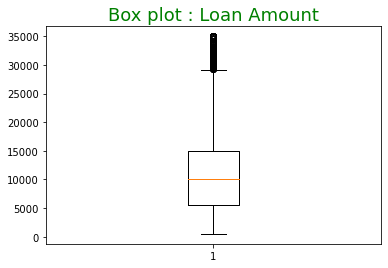

In [57]:

#Plot boxplot:
plt.boxplot(df['loan_amnt'])

# Adding and formatting title
plt.title("Box plot : Loan Amount",fontdict={'fontsize': 18, 'fontweight' : 5, 'color' : 'Green'})
plt.show()


In [58]:
plot_box_chart(pd.DataFrame(df["loan_amnt"]))

**`Observation : `**

<font color = blue> Majority of loan amount is distributed in the range of 5500 and 15,000.</font>



### <span style= 'background:gold'> 2. Annual Income  </span>

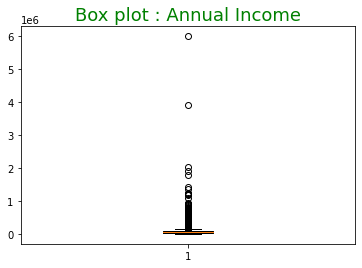

In [59]:

#Plot boxplot:
plt.boxplot(df['annual_inc'])

# Adding and formatting title
plt.title("Box plot : Annual Income",fontdict={'fontsize': 18, 'fontweight' : 5, 'color' : 'Green'})
plt.show()


In [60]:
plot_box_chart(pd.DataFrame(df["annual_inc"]))


**`Observation : `**

<font color = blue> Here we can see so many outliers. Let us check using describe().</font>

In [61]:
#check for distribution:

df['annual_inc'].describe()


count     37544.000000
mean      69407.080230
std       64676.984485
min        4000.000000
25%       41000.000000
50%       60000.000000
75%       83000.000000
max     6000000.000000
Name: annual_inc, dtype: float64


**`Observation : `**

<font color = blue>The mean = 69407 while and max value = 6000000, thus there is huge diffrence.So basically max value is an outlier which needs to be corrected to avoid biasing towards large value.</font>


## Treating Outlier in Annual income 

In [62]:

outlier = df["annual_inc"].quantile(0.99)        #99% quantile

df = df[df["annual_inc"] < outlier]


In [63]:
df["annual_inc"].describe()

count    37165.000000
mean     65903.070210
std      35153.363496
min       4000.000000
25%      40906.000000
50%      59000.000000
75%      81600.000000
max     234996.000000
Name: annual_inc, dtype: float64


<font color = blue>Now, max value is 234996, hence outliers removed successfully!</font>

In [64]:
plot_box_chart(pd.DataFrame(df["annual_inc"]))

**`Observation :`**

<font color = blue>Annual Income varies between 40.9k to 81.6k</font>


### <span style= 'background:gold'> 3. Interest Rate :   </span>

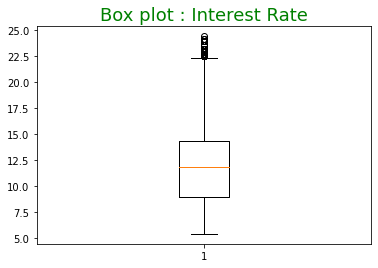

In [65]:

#plot boxplot
plt.boxplot(df['int_rate'])

# Adding and formatting title
plt.title("Box plot : Interest Rate",fontdict={'fontsize': 18, 'fontweight' : 5, 'color' : 'Green'})
plt.show()


In [66]:
plot_box_chart(pd.DataFrame(df["int_rate"]))

**`Observation :`** 

<font color = blue>Majority of interest rate is between 8.94 to 14.3575</font>


### <span style= 'background:gold'>  4. funded_amnt_inv :   </span>

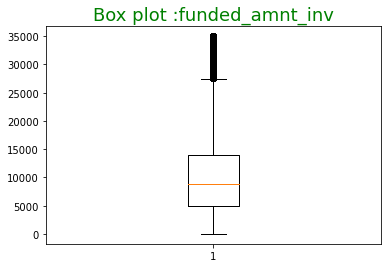

In [67]:

#plot boxplot
plt.boxplot(df['funded_amnt_inv'])

# Adding and formatting title
plt.title("Box plot :funded_amnt_inv",fontdict={'fontsize': 18, 'fontweight' : 5, 'color' : 'Green'})
plt.show()


In [68]:
plot_box_chart(pd.DataFrame(df["funded_amnt_inv"]))

**`Observation :`**

<font color = blue> Here we can see lot number of outliers can be seen in "funded_amnt_inv" column.</font>

### Outlier treatment

In [69]:

outlier = df["funded_amnt_inv"].quantile(0.95)      #95%

df= df[df["funded_amnt_inv"] < outlier]


In [70]:
plot_box_chart(pd.DataFrame(df["funded_amnt_inv"]))


<font color = blue> Majority of outliers are removed from "funded_amnt_inv" !!!</font>


### <span style= 'background:gold'>  5. Debt to Income Ratio  :   </span>

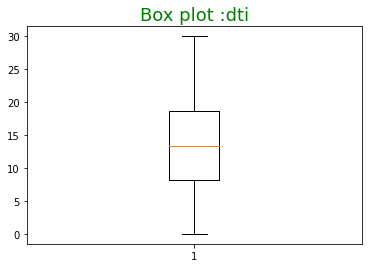

In [71]:

#plot boxplot
plt.boxplot(df['dti'])

# Adding and formatting title
plt.title("Box plot :dti",fontdict={'fontsize': 18, 'fontweight' : 5, 'color' : 'Green'})
plt.show()


In [72]:
plot_box_chart(pd.DataFrame(df["dti"]))

**`Observation :`**

<font color = blue> Most of the "Debt to Income" ratio is distributed in the range of 8.24 to 18.6</font>


### <span style= 'background:gold'>  6. Installment  :   </span>

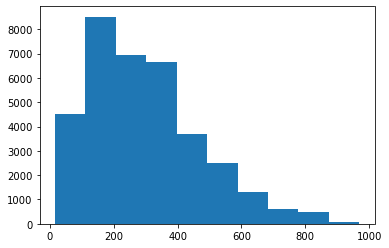

In [73]:

#plot histogram:
plt.hist(df['installment'])
plt.show()


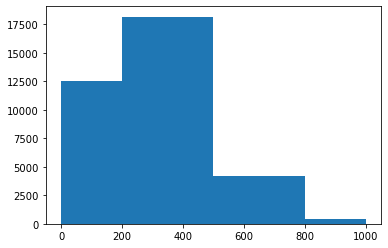

In [74]:
#creating bins :

plt.hist(df['installment'],bins=[0,200,500,800,1000])
plt.show()

**`Observation :`**

<font color = blue> 200- 500 range has highest insatllment</font>

## Categorical Variables 


### <span style= 'background:gold'>  1. Home Ownership :   </span>

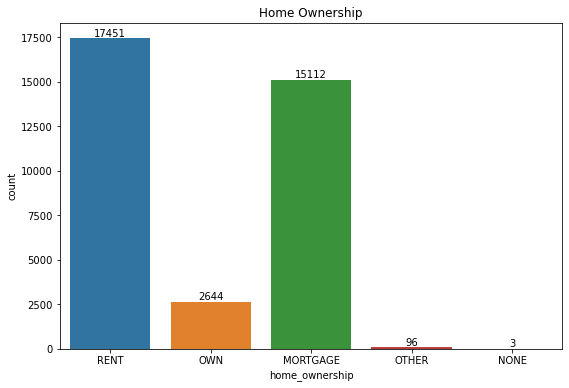

In [75]:
#plot Countplot:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="home_ownership", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Home Ownership")
plt.show()


**`Observation :`**

<font color = blue>  Mostly rent, mortgage and own category contributes to loan application while "other" and 'none' doesn't have much contribution.<br>
Hence we can remove them.</font>

In [76]:
#removing Others and none from "home ownwrship":

df = df[df["home_ownership"].isin(["OWN","RENT","MORTGAGE"]) ]
df["home_ownership"].unique()


array(['RENT', 'OWN', 'MORTGAGE'], dtype=object)


### <span style= 'background:gold'>  2. Emp_length :   </span>

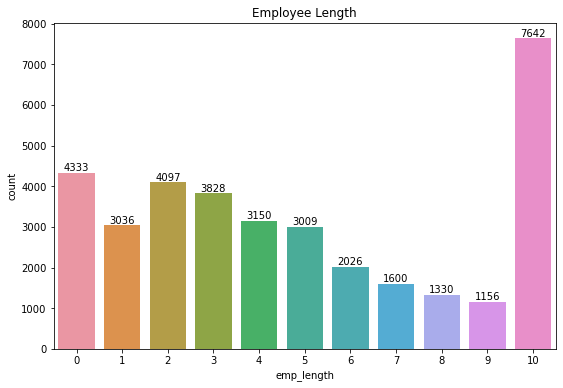

In [77]:
#plt countplot:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="emp_length", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Employee Length")
plt.show()


**`Observation :`**


<font color = blue>  Applicants having experience 10+ years have taken maximum loan.</font>


### <span style= 'background:gold'>  3. pub_rec_bankruptcies :   </span>

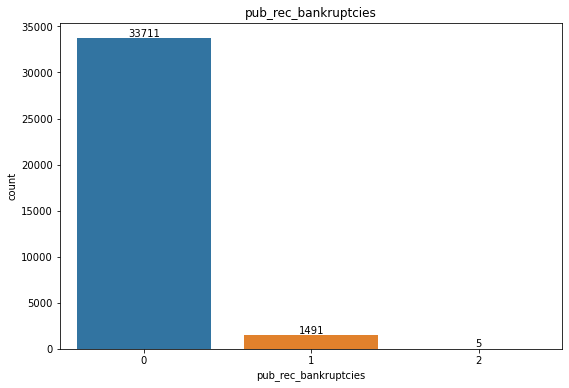

In [78]:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="pub_rec_bankruptcies", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("pub_rec_bankruptcies")
plt.show()


**`Observation :`**

<font color = blue>  Contains 3 unique values out of which more than 75% values are 0</font>


### <span style= 'background:gold'>  4. Verification Status :   </span>

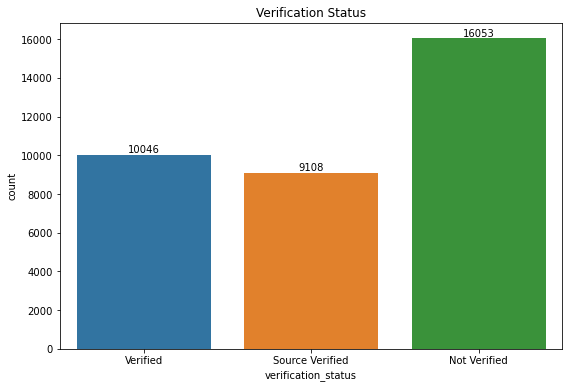

In [79]:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="verification_status", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Verification Status")
plt.show()


**`Observation :`**

<font color = blue>  The verification status can be "yes" or "no".<br>
The "Source_verified" and "verified" seems to be same.</font>

##### <span style= 'background:lime'> Assuming "Source_verified" same as "verified"... hence combining these two:   </span>

In [80]:

df["verification_status"] = df["verification_status"].replace("Source Verified","Verified")


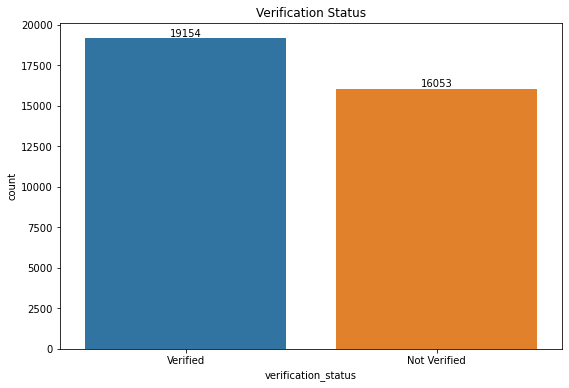

In [81]:
#ploting df["verification_status"]:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="verification_status", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Verification Status")
plt.show()



### <span style= 'background:gold'>   5. Purpose :   </span>

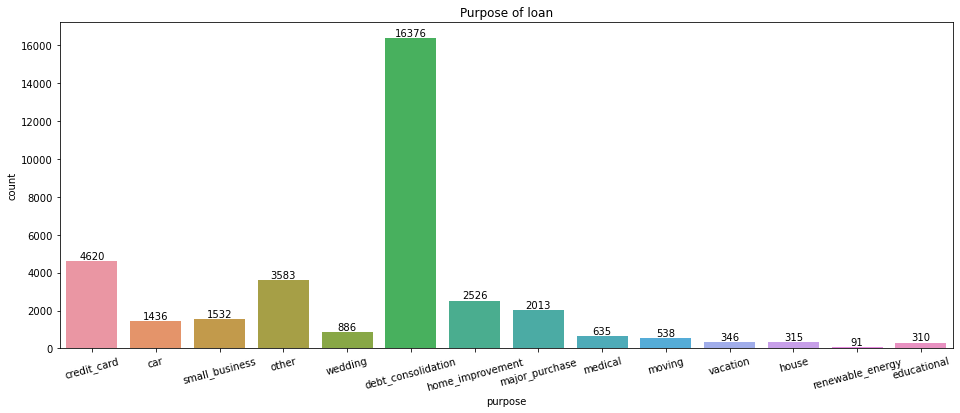

In [82]:

plt.figure(figsize=(16, 6))

ax = sns.countplot(x="purpose", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Purpose of loan")
plt.xticks(rotation=15)                           #rotate x label for proper display
plt.show()


**`Observation : `**

<font color = blue>  "debt_consolidation" makes highest purpose of loan than other categories.</font>


### <span style= 'background:gold'>  6. Term :   </span>

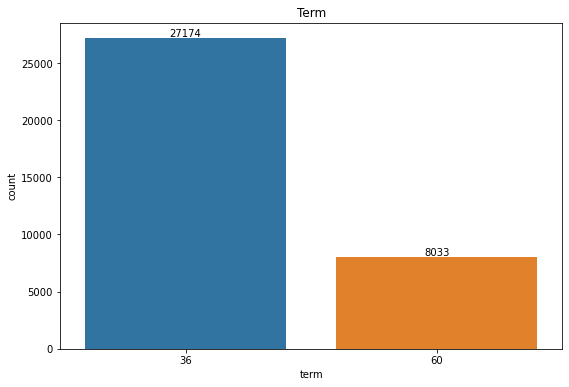

In [83]:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="term", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Term")
plt.show()



 
**`Observation : `**

<font color = blue>  Majority of applicant choose to term = 36</font>


### <span style= 'background:gold'> 7. Grade :   </span>

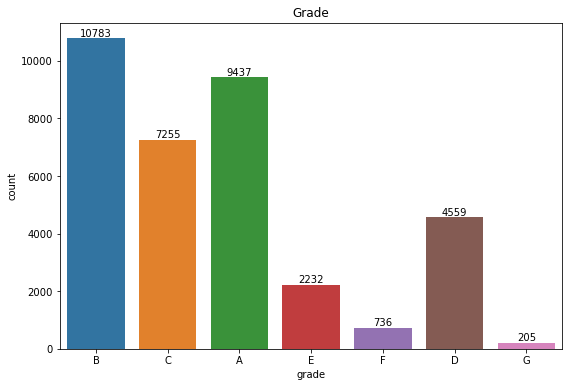

In [84]:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="grade", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Grade")
plt.show()


**`Observation : `**

<font color = blue> Applicants having Grade : A,B,C,D seems to apply for loan compared to Grade : E, F,G</font>


### <span style= 'background:gold'> 8. Sub-grade :   </span>

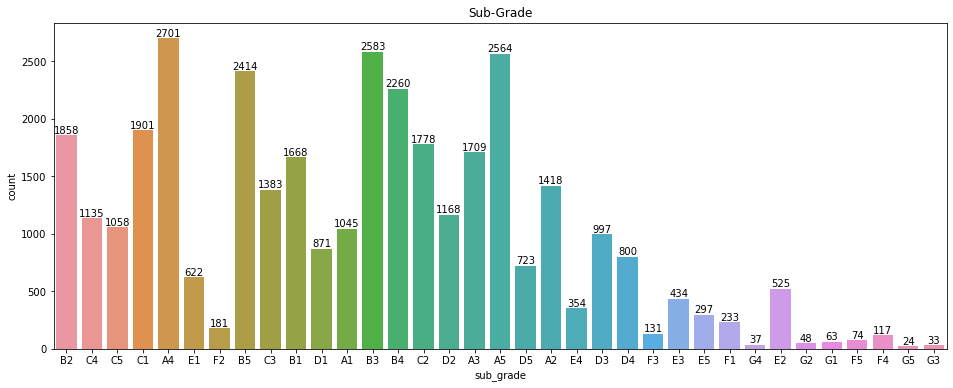

In [85]:

plt.figure(figsize=(16, 6))

ax = sns.countplot(x="sub_grade", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("Sub-Grade")
plt.show()



### <span style= 'background:gold'>  9. Issued Year :   </span>

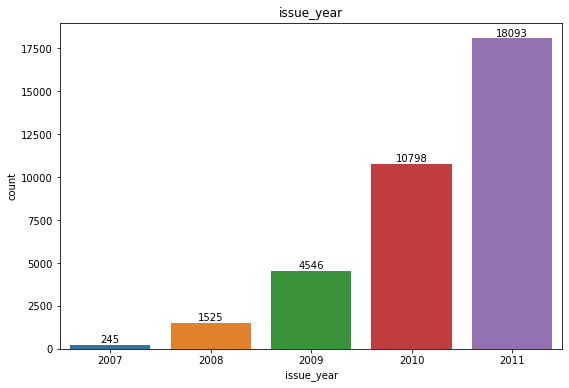

In [86]:

plt.figure(figsize=(9, 6))

ax = sns.countplot(x="issue_year", data=df)

for container in ax.containers:                    # to display count on top of bar
    ax.bar_label(container)

plt.title("issue_year")
plt.show()



**`Observation : `**

<font color = blue>2011 shows highest no of loan application</font>


#   <font color =Green> Bivariate Analysis :  </font>


### <span style= 'background:gold'> 1. Loan Status Vs. Purpose :   </span>

In [87]:

#First plot
tr0 = go.Bar(
    x = df[df["loan_status"]== 1]["purpose"].value_counts().index.values,
    y = df[df["loan_status"]== 1]["purpose"].value_counts().values,
    name='Charged off'
)

#Second plot
tr1 = go.Bar(
    x = df[df["loan_status"]== 0]["purpose"].value_counts().index.values,
    y = df[df["loan_status"]== 0]["purpose"].value_counts().values,
    name="Fully Paid"
)

data = [tr0, tr1]

layout = go.Layout(
    title='Purpose wise distribution'
)


fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='Purpose-Grouped')

**`Observation : `**

<font color = blue>Most of the defaulter apply loan for "debt_consolidation" purpose</font>


### <span style= 'background:gold'> 2. Loan Status Vs. Home Ownership :   </span>

In [88]:

#First plot
tr0 = go.Bar(
    x = df[df["loan_status"]== 1]["home_ownership"].value_counts().index.values,
    y = df[df["loan_status"]== 1]["home_ownership"].value_counts().values,
    name='Charged off'
)

#Second plot
tr1 = go.Bar(
    x = df[df["loan_status"]== 0]["home_ownership"].value_counts().index.values,
    y = df[df["loan_status"]== 0]["home_ownership"].value_counts().values,
    name="Fully Paid"
)

data = [tr0, tr1]

layout = go.Layout(
    title='Home_Ownership wise distribution'
)


fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='home_ownership-Grouped')



### <span style= 'background:gold'> 3. Employee length Vs. Loan Status :   </span>

In [89]:

#First plot
tr0 = go.Bar(
    x = df[df["loan_status"]== 1]["home_ownership"].value_counts().index.values,
    y = df[df["loan_status"]== 1]["home_ownership"].value_counts().values,
    name='Charged off'
)

#Second plot
tr1 = go.Bar(
    x = df[df["loan_status"]== 0]["home_ownership"].value_counts().index.values,
    y = df[df["loan_status"]== 0]["home_ownership"].value_counts().values,
    name="Fully Paid"
)

data = [tr0, tr1]

layout = go.Layout(
    title='Home_Ownership wise distribution'
)


fig = go.Figure(data=data, layout=layout)

py.iplot(fig, filename='home_ownership-Grouped')


## <font color = Crimson>Pie Chart for Categorical Variable Analysis :  </font>

In [90]:

#Separating churn and non churn customers

Fully_Paid    = df[df["loan_status"] == 0]
Defaulter = df[df["loan_status"] == 1]


In [91]:

#Separating catagorical and numerical columns

target_col = ["loan_status"]
cat_cols   = df.nunique()[df.nunique() < 7].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col]
num_cols   = [x for x in df.columns if x not in cat_cols + target_col]


In [92]:

#function  for pie plot for customer attrition types
def plot_pie(column) :
    
    trace1 = go.Pie(values  = Fully_Paid[column].value_counts().values.tolist(),
                    labels  = Fully_Paid[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    domain  = dict(x = [0,.48]),
                    name    = "Fully_Paid",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    hole    = .6
                   )
    trace2 = go.Pie(values  = Defaulter[column].value_counts().values.tolist(),
                    labels  = Defaulter[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    domain  = dict(x = [.52,1]),
                    hole    = .6,
                    name    = "Defaulter" 
                   )


    layout = go.Layout(dict(title = column + " distribution of Applicant",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            annotations = [dict(text = "Fully Paid",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .15, y = .5),
                                           dict(text = "Defaulter",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .88,y = .5
                                               )
                                          ]
                           )
                      )
    data = [trace1,trace2]
    fig  = go.Figure(data = data,layout = layout)
    py.iplot(fig)

#for all categorical columns plot pie
for i in cat_cols :
    plot_pie(i)
    
    


### `Observation : `

<font color = blue>"Term" : Chance of defaulter is more for 60 than 30 <br>
"Home Ownership" : Applicants living in Rent are more likely to default <br>
"Verification Status" : Verified applicants are more likely to default
</font>

## <font color = Crimson>Histogram for Continuous Variable Analysis :  </font>

In [93]:

#function  for histogram for loan status:

def histogram(column) :
    trace1 = go.Histogram(x  = Fully_Paid[column],
                          histnorm= "percent",
                          name = "Fully Paid",
                          marker = dict(line = dict(width = .5,
                                                    color = "black"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = Defaulter[column],
                          histnorm = "percent",
                          name = "Defaulter",
                          marker = dict(line = dict(width = .5,
                                              color = "black"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution for Loan Status ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    py.iplot(fig)

    
#for all categorical columns plot histogram    
for i in num_cols :
    histogram(i)
    
    


### `Observation :  `

1. "Grade"          : For grades C, D, E, F, G  defaulter rate is more than paid ones.
<br>
2. "loan amt"       : As loan amt increases, nnumber of defaulter increases (directly proportional). <br>
3. "funded_amt_inv" : No such correlation can be concluded. <br>
4. "int_rate"       : Interest rate is directly proportional to defaulters(as int_rate increases, defaulters also increases)  
5. "installment"    : As installment increases, defaulters increases after certain limit.
6. "Emp lenghth"    : Charged off percentage is almost constant.  
7. "Annual income"  : Annual income is indirectly proportional to defaulters (Annual income less==>more defaulters )
8. "Purpose:"       : small business have more default ("debt con", "other" also defaults but small business % is more than double)  
9. "DTI"            : dti increases ==> defaulters increases

Grade= C,D,E,F,G : default>paid
loan amt increases,defaulter increases
funded_amt_inv : no such correlation can be concluded
int_rate increases==>defaulters increases
installment increases==>defaulters increases after certain limit
Emp lenghth : charged off percentage is almost constant.
Annual income less==>more defaulters
Purpose: small business ==> more default (debt con,other also defaults but small business % is more than double
dti increases ==> defaulters increases


Imp:
Term
Grade
loan amt
int_rate
installment
Annual income
Purpose:
dti


#   <font color =Green>  Multivariate Analysis :  </font>


## <font color = Crimson> Correlation and Heatmap:  </font>

In [94]:

#find out correlation between different variables:

corr = df.corr(method ='pearson')
corr


,loan_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,annual_inc,loan_status,dti,pub_rec_bankruptcies,issue_month,issue_year
loan_amnt,1.000000,0.904597,0.303923,0.235255,0.914958,0.124864,0.353017,0.057614,0.074035,-0.016744,0.036386,0.044210
funded_amnt_inv,0.904597,1.000000,0.303076,0.230693,0.871197,0.139561,0.323304,0.028434,0.085547,-0.018057,0.055256,0.225186
term,0.303923,0.303076,1.000000,0.415730,0.019761,0.091876,0.038729,0.172356,0.077966,0.025215,0.026346,0.221943
int_rate,0.235255,0.230693,0.415730,1.000000,0.213602,-0.019169,0.018138,0.212169,0.109549,0.092579,0.022851,0.016826
installment,0.914958,0.871197,0.019761,0.213602,1.000000,0.095206,0.347382,0.022182,0.060509,-0.015295,0.010266,-0.017522
emp_length,0.124864,0.139561,0.091876,-0.019169,0.095206,1.000000,0.169086,0.013461,0.052711,0.067734,0.020636,0.112600
annual_inc,0.353017,0.323304,0.038729,0.018138,0.347382,0.169086,1.000000,-0.066623,-0.114632,-0.003006,0.009618,0.010719
loan_status,0.057614,0.028434,0.172356,0.212169,0.022182,0.013461,-0.066623,1.000000,0.041116,0.045877,0.024377,0.018015
dti,0.074035,0.085547,0.077966,0.109549,0.060509,0.052711,-0.114632,0.041116,1.000000,0.008845,0.013241,0.092846
pub_rec_bankruptcies,-0.016744,-0.018057,0.025215,0.092579,-0.015295,0.067734,-0.003006,0.045877,0.008845,1.000000,-0.017924,0.012329


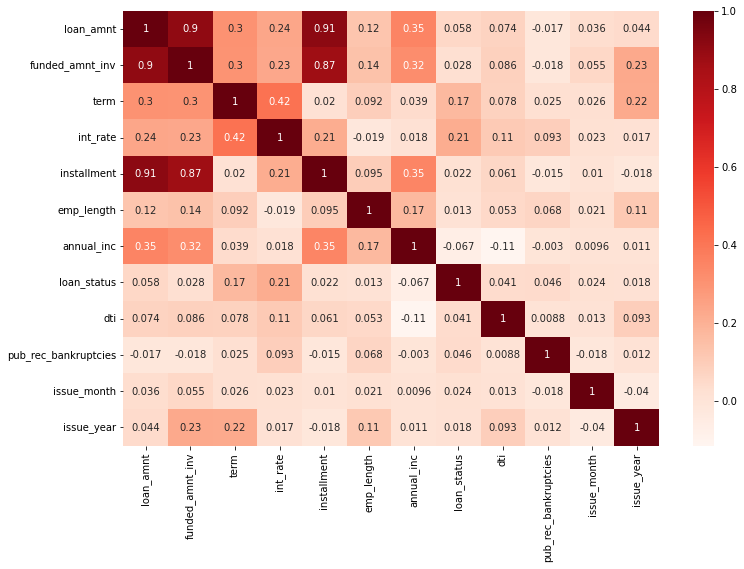

In [95]:

#View correlation obtained in heatmap:

plt.figure(figsize=(12, 8))
sns.heatmap(corr,annot=True,cmap='Reds')
plt.show()


### `Observation :`

1. "loan_amnt" have good positive correlation with "installment" and "funded_amnt_inv" variable i.e., "loan amount" will increase with increase in "installment" and "funded_amnt_inv".
2. "funded_amnt_inv"have positive correlation with "installment".
3. Other have very poor correlation so there is not much linear relationship between them



## <font color = Crimson> Pairplot :  </font>

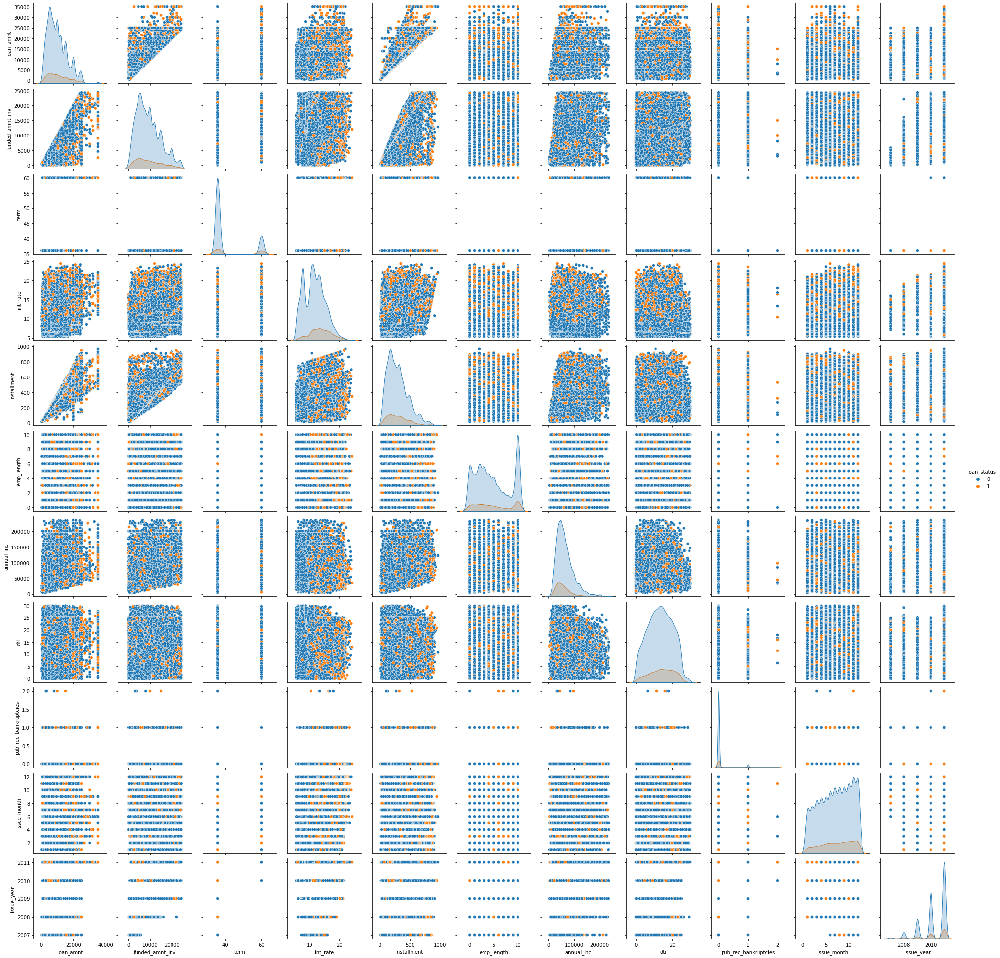

In [96]:
#pairplot

sns.pairplot(df,hue='loan_status')
plt.show()



# <span style= 'background:yellow'> Conclusion :   </span>

## <font color = blue>At the end of Exploratory Data Analysis (EDA) part, we have identified the top most important features from the dataset (out of 111 features):
    
> ### <span style= 'background:beige'> 1. Annual income  </span>
> ### <span style= 'background:beige'>  2. Loan Amount  </span>
> ### <span style= 'background:beige'> 3. Purpose  </span>
> ### <span style= 'background:beige'> 4. Term  </span>
> ### <span style= 'background:beige'>5. Grade  </span>
> ### <span style= 'background:beige'>  6. Interest Rate </span>
> ### <span style= 'background:beige'> 7. Installment  </span>
> ### <span style= 'background:beige'> 8. Debt-to-Income(dti)  </span>
</font>